# Load packages and set work dir

In [2]:
import os
import numpy as np
import pandas as pd
import sklearn
import matplotlib.pyplot as plt
import seaborn as sns
import keras
import tensorflow as tf
import pyxlsb
from pandas.plotting import scatter_matrix
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn_extra.cluster import KMedoids
from kneed import KneeLocator
import seaborn as sns
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier 
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn import tree
from datetime import datetime
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import Lasso
from sklearn.preprocessing import MinMaxScaler
import warnings
import matplotlib.image as mpimg
warnings.filterwarnings('ignore')
%matplotlib inline

In [3]:
os.chdir("./corn dataset/")

# For fun -- image processing

In [13]:
ct0 = mpimg.imread('P1.jpg')
ct0.shape

(3192, 2581, 3)

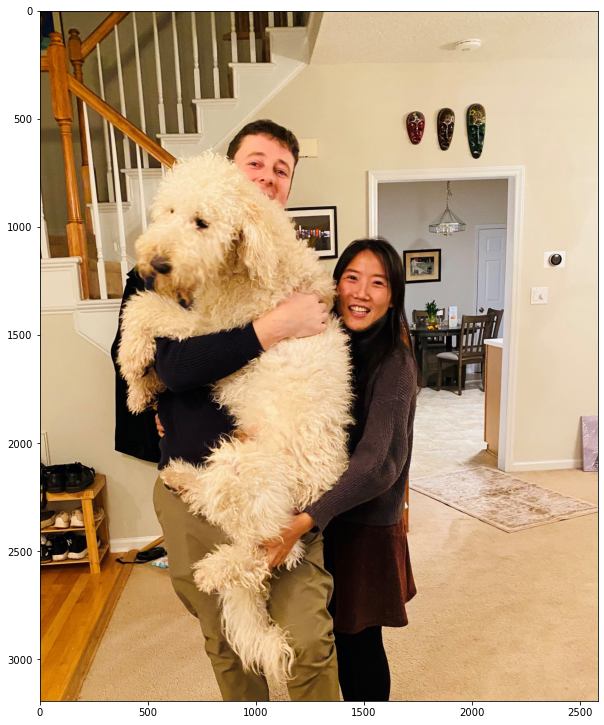

In [14]:
plt.figure(figsize=(10,15))
ct = Image.open('P1.jpg')
plt.imshow(ct)
plt.show()

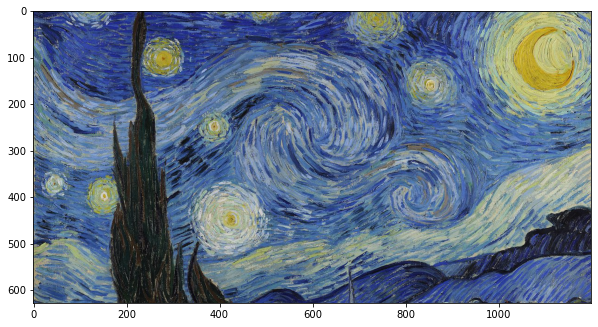

In [15]:
plt.figure(figsize=(10,15))
syl = Image.open('Style.jpg')
plt.imshow(syl)
plt.show()

In [186]:
print(syl.size)
print(ct.size)

(1200, 628)
(2581, 3192)


In [187]:
from PIL import Image

syl2 = syl.resize(ct.size)

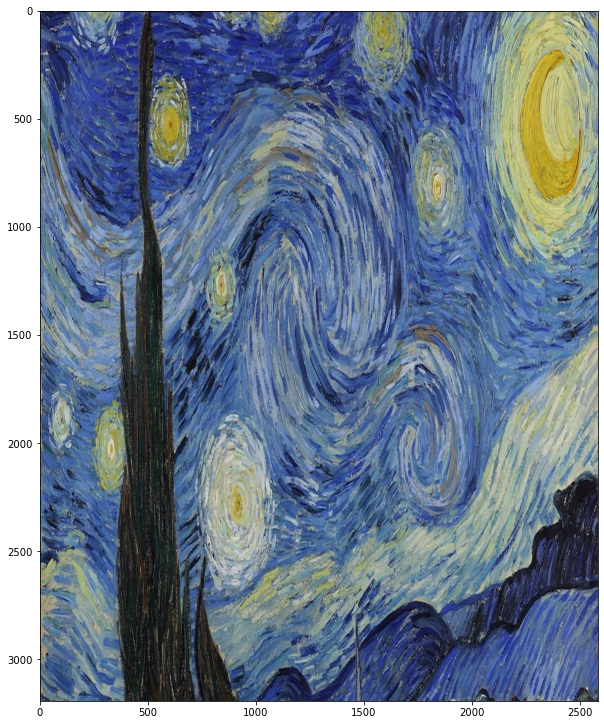

In [188]:
plt.figure(figsize=(10,15))
plt.imshow(syl2)
plt.show()

In [1]:
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (10,10)
mpl.rcParams['axes.grid'] = False
from PIL import Image
import numpy as np
import time
import functools
# %tensorflow_version 1.x
import tensorflow as tf
from tensorflow.python.keras.preprocessing import image as kp_image
from tensorflow.python.keras import models 
from tensorflow.python.keras import losses
from tensorflow.python.keras import layers
from tensorflow.python.keras import backend as K

In [3]:
# tf.enable_eager_execution()
tf.compat.v1.enable_eager_execution()
print("Eager execution: {}".format(tf.executing_eagerly()))

Eager execution: True


In [19]:
content_path = './P1.jpg'
style_path = './Style.jpg'

In [20]:
def load_img(path_to_img):
  max_dim = 800
  img = Image.open(path_to_img)
  long = max(img.size)
  scale = max_dim/long
  img = img.resize((round(img.size[0]*scale), round(img.size[1]*scale)), Image.ANTIALIAS)
  
  img = kp_image.img_to_array(img)
  
  # We need to broadcast the image array such that it has a batch dimension 
  img = np.expand_dims(img, axis=0)
  return img

def imshow(img, title=None):
  # Remove the batch dimension
  out = np.squeeze(img, axis=0)
  # Normalize for display 
  out = out.astype('uint8')
  plt.imshow(out)
  if title is not None:
    plt.title(title)
  plt.imshow(out)

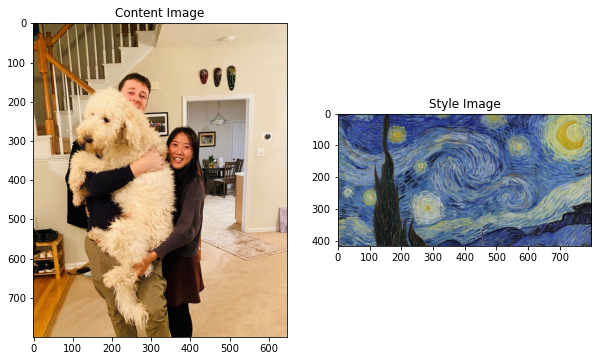

In [21]:
plt.figure(figsize=(10,10))

content = load_img(content_path).astype('uint8')
style = load_img(style_path).astype('uint8')

plt.subplot(1, 2, 1)
imshow(content, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style, 'Style Image')
plt.show()

In [22]:
def load_and_process_img(path_to_img):
  img = load_img(path_to_img)
  img = tf.keras.applications.vgg19.preprocess_input(img)
  return img

def deprocess_img(processed_img):
  x = processed_img.copy()
  if len(x.shape) == 4:
    x = np.squeeze(x, 0)
  assert len(x.shape) == 3, ("Input to deprocess image must be an image of "
                             "dimension [1, height, width, channel] or [height, width, channel]")
  if len(x.shape) != 3:
    raise ValueError("Invalid input to deprocessing image")
  
  # perform the inverse of the preprocessing step
  x[:, :, 0] += 103.939
  x[:, :, 1] += 116.779
  x[:, :, 2] += 123.68
  x = x[:, :, ::-1]

  x = np.clip(x, 0, 255).astype('uint8')
  return x

In [23]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv2'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

In [25]:
def get_model():
  # Load our model. We load pretrained VGG, trained on imagenet data
  
  vgg = tf.keras.applications.vgg19.VGG19(include_top=False, weights='imagenet')
  vgg.trainable = False
  # Get output layers corresponding to style and content layers 
  style_outputs = [vgg.get_layer(name).output for name in style_layers]
  content_outputs = [vgg.get_layer(name).output for name in content_layers]
  model_outputs = style_outputs + content_outputs
  # Build model 
  return models.Model(vgg.input, model_outputs)

def get_content_loss(base_content, target):
  return tf.reduce_mean(tf.square(base_content - target))

In [26]:
def gram_matrix(input_tensor):
  # We make the image channels first 
  channels = int(input_tensor.shape[-1])
  a = tf.reshape(input_tensor, [-1, channels])
  n = tf.shape(a)[0]
  gram = tf.matmul(a, a, transpose_a=True)
  return gram / tf.cast(n, tf.float32)

def get_style_loss(base_style, gram_target):
  """Expects two images of dimension h, w, c"""
  # height, width, num filters of each layer
  # We scale the loss at a given layer by the size of the feature map and the number of filters
  height, width, channels = base_style.get_shape().as_list()
  gram_style = gram_matrix(base_style)
  
  return tf.reduce_mean(tf.square(gram_style - gram_target))# / (4. * (channels ** 2) * (width * height) ** 2)

In [27]:
def get_feature_representations(model, content_path, style_path):
  """Helper function to compute our content and style feature representations.

  This function will simply load and preprocess both the content and style 
  images from their path. Then it will feed them through the network to obtain
  the outputs of the intermediate layers. 
  
  Arguments:
    model: The model that we are using.
    content_path: The path to the content image.
    style_path: The path to the style image
    
  Returns:
    returns the style features and the content features. 
  """
  # Load our images in 
  content_image = load_and_process_img(content_path)
  style_image = load_and_process_img(style_path)
  
  # batch compute content and style features
  style_outputs = model(style_image)
  content_outputs = model(content_image)
  
  
  # Get the style and content feature representations from our model  
  style_features = [style_layer[0] for style_layer in style_outputs[:num_style_layers]]
  content_features = [content_layer[0] for content_layer in content_outputs[num_style_layers:]]
  return style_features, content_features

In [28]:
def compute_loss(model, loss_weights, init_image, gram_style_features, content_features):
  """This function will compute the loss total loss.
  
  Arguments:
    model: The model that will give us access to the intermediate layers
    loss_weights: The weights of each contribution of each loss function. 
      (style weight, content weight, and total variation weight)
    init_image: Our initial base image. This image is what we are updating with 
      our optimization process. We apply the gradients wrt the loss we are 
      calculating to this image.
    gram_style_features: Precomputed gram matrices corresponding to the 
      defined style layers of interest.
    content_features: Precomputed outputs from defined content layers of 
      interest.
      
  Returns:
    returns the total loss, style loss, content loss, and total variational loss
  """
  style_weight, content_weight = loss_weights
  
  # Feed our init image through our model. This will give us the content and 
  # style representations at our desired layers. Since we're using eager
  # our model is callable just like any other function!
  model_outputs = model(init_image)
  
  style_output_features = model_outputs[:num_style_layers]
  content_output_features = model_outputs[num_style_layers:]
  
  style_score = 0
  content_score = 0

  # Accumulate style losses from all layers
  # Here, we equally weight each contribution of each loss layer
  weight_per_style_layer = 1.0 / float(num_style_layers)
  for target_style, comb_style in zip(gram_style_features, style_output_features):
    style_score += weight_per_style_layer * get_style_loss(comb_style[0], target_style)
    
  # Accumulate content losses from all layers 
  weight_per_content_layer = 1.0 / float(num_content_layers)
  for target_content, comb_content in zip(content_features, content_output_features):
    content_score += weight_per_content_layer* get_content_loss(comb_content[0], target_content)
  
  style_score *= style_weight
  content_score *= content_weight

  # Get total loss
  loss = style_score + content_score 
  return loss, style_score, content_score

In [29]:
def compute_grads(cfg):
  with tf.GradientTape() as tape: 
    all_loss = compute_loss(**cfg)
  # Compute gradients wrt input image
  total_loss = all_loss[0]
  return tape.gradient(total_loss, cfg['init_image']), all_loss

In [33]:
import IPython.display

def run_style_transfer(content_path, 
                       style_path,
                       num_iterations=1000,
                       content_weight=1e3, 
                       style_weight=1e-2):
  # We don't need to (or want to) train any layers of our model, so we set their
  # trainable to false. 
  model = get_model() 
  for layer in model.layers:
    layer.trainable = False
  
  # Get the style and content feature representations (from our specified intermediate layers) 
  style_features, content_features = get_feature_representations(model, content_path, style_path)
  gram_style_features = [gram_matrix(style_feature) for style_feature in style_features]
  
  # Set initial image
  init_image = load_and_process_img(content_path)
  init_image = tf.Variable(init_image, dtype=tf.float32)
  # Create our optimizer
  # opt = tf.train.AdamOptimizer(learning_rate=5, beta1=0.99, epsilon=1e-1)
  opt = tf.compat.v1.train.AdamOptimizer(learning_rate=5, beta1=0.99, epsilon=1e-1)

  # For displaying intermediate images 
  iter_count = 1
  
  # Store our best result
  best_loss, best_img = float('inf'), None
  
  # Create a nice config 
  loss_weights = (style_weight, content_weight)
  cfg = {
      'model': model,
      'loss_weights': loss_weights,
      'init_image': init_image,
      'gram_style_features': gram_style_features,
      'content_features': content_features
  }
    
  # For displaying
  num_rows = 2
  num_cols = 5
  display_interval = num_iterations/(num_rows*num_cols)
  start_time = time.time()
  global_start = time.time()
  
  norm_means = np.array([103.939, 116.779, 123.68])
  min_vals = -norm_means
  max_vals = 255 - norm_means   
  
  imgs = []
  for i in range(num_iterations):
    grads, all_loss = compute_grads(cfg)
    loss, style_score, content_score = all_loss
    opt.apply_gradients([(grads, init_image)])
    clipped = tf.clip_by_value(init_image, min_vals, max_vals)
    init_image.assign(clipped)
    end_time = time.time() 
    
    if loss < best_loss:
      # Update best loss and best image from total loss. 
      best_loss = loss
      best_img = deprocess_img(init_image.numpy())

    if i % display_interval== 0:
      start_time = time.time()
      
      # Use the .numpy() method to get the concrete numpy array
      plot_img = init_image.numpy()
      plot_img = deprocess_img(plot_img)
      imgs.append(plot_img)
      IPython.display.clear_output(wait=True)
      IPython.display.display_png(Image.fromarray(plot_img))
      print('Iteration: {}'.format(i))        
      print('Total loss: {:.4e}, ' 
            'style loss: {:.4e}, '
            'content loss: {:.4e}, '
            'time: {:.4f}s'.format(loss, style_score, content_score, time.time() - start_time))
  print('Total time: {:.4f}s'.format(time.time() - global_start))
  IPython.display.clear_output(wait=True)
  plt.figure(figsize=(14,4))
  for i,img in enumerate(imgs):
      plt.subplot(num_rows,num_cols,i+1)
      plt.imshow(img)
      plt.xticks([])
      plt.yticks([])
      
  return best_img, best_loss 

In [38]:
import torch
import torch.nn as nn
import torchvision
import torchvision.models as models
import torchvision.transforms as transforms
import torch.optim as optim
from torchvision.utils import save_image
from PIL import Image
import matplotlib.pyplot as plt

In [39]:
model = models.vgg19(pretrained=True)
device = 'cuda' if torch.cuda.is_available() else 'cpu'

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to C:\Users\s1052014/.cache\torch\hub\checkpoints\vgg19-dcbb9e9d.pth


In [40]:
class VGG(nn.Module):
    def __init__(self):
        super(VGG,self).__init__()
        self.req_features = ['0','5','10','19','28']
        self.model = models.vgg19(pretrained=True).features[:29]
    def forward(self,x):
        features = []
        for layer_num,layer in enumerate(self.model):
            x = layer(x)
            if(str(layer_num) in self.req_features):
                features.append(x)
        return features

In [42]:
def image_loader(path):
    image = Image.open(path)
    loader = transforms.Compose([transforms.Resize((512,512)),
transforms.ToTensor()])
    image = loader(image).unsqueeze(0)
    return image.to(device,torch.float)

original_image = image_loader('./P1.jpg')
style_image = image_loader('./Style2.jpg')
generated_image = original_image.clone().requires_grad_(True)

In [43]:
def calc_content_loss(gen_feat,orig_feat):
    content_l = torch.mean((gen_feat - orig_feat)**2)
    return content_l

def calc_style_loss(gen,style):
    batch_size,channel,height,width = gen.shape
    G = torch.mm(gen.view(channel,height*width),gen.view(channel,height*width).t())
    A = torch.mm(style.view(channel,height*width),style.view(channel,height*width).t())
    style_l = torch.mean((G-A)**2)
    return style_l

def calculate_loss(gen_features,orig_features,style_features):
    style_loss=content_loss=0
    for gen,con,style in zip(gen_features,orig_features,style_features):
        content_loss += calc_content_loss(gen,con)
        style_loss += calc_style_loss(gen,style)
    total_loss = alpha*content_loss + beta*style_loss
    return total_loss

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


0
tensor(3644573.2500, grad_fn=<AddBackward0>)


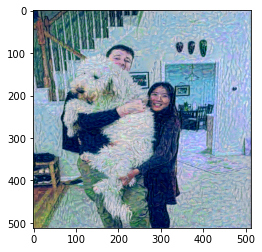

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


50
tensor(5174866., grad_fn=<AddBackward0>)


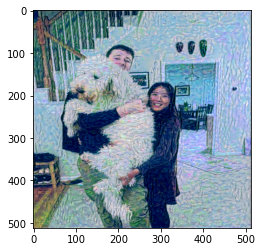

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


100
tensor(4103516., grad_fn=<AddBackward0>)


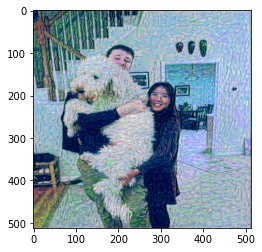

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


150
tensor(3784472.7500, grad_fn=<AddBackward0>)


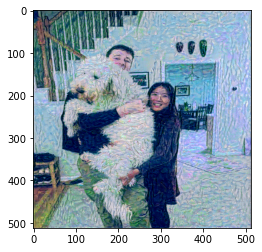

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


200
tensor(3574043., grad_fn=<AddBackward0>)


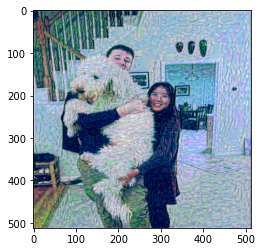

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


250
tensor(3410698., grad_fn=<AddBackward0>)


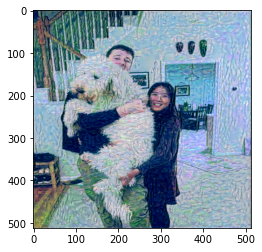

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


300
tensor(3361983.5000, grad_fn=<AddBackward0>)


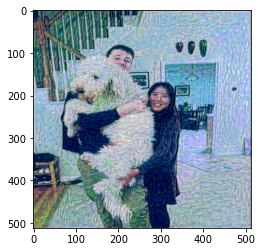

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


350
tensor(3169863.7500, grad_fn=<AddBackward0>)


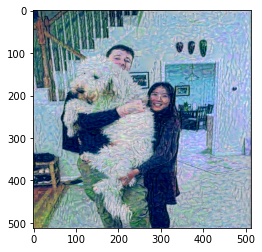

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


400
tensor(3086856.2500, grad_fn=<AddBackward0>)


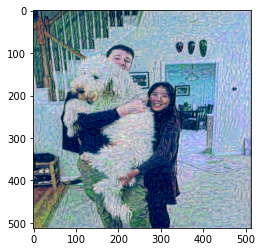

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


450
tensor(3967684., grad_fn=<AddBackward0>)


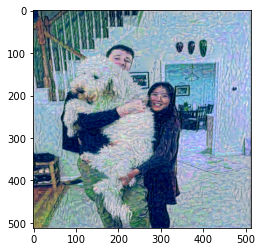

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


500
tensor(2965881., grad_fn=<AddBackward0>)


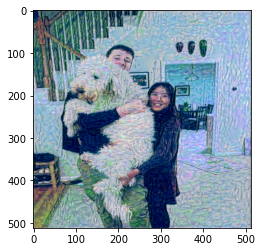

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


550
tensor(2851501.7500, grad_fn=<AddBackward0>)


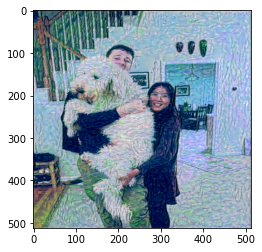

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


600
tensor(2824257.7500, grad_fn=<AddBackward0>)


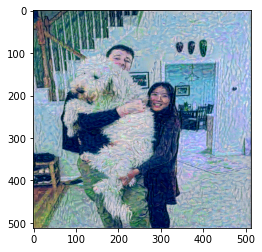

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


650
tensor(3133395.7500, grad_fn=<AddBackward0>)


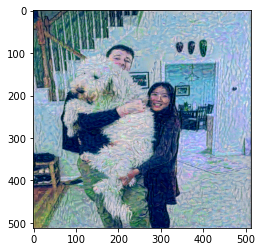

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


700
tensor(2711316.5000, grad_fn=<AddBackward0>)


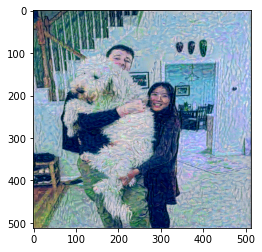

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


750
tensor(2600406.5000, grad_fn=<AddBackward0>)


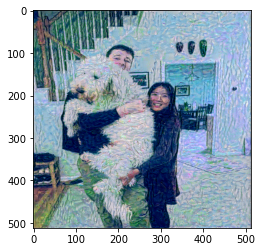

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


800
tensor(2715639.5000, grad_fn=<AddBackward0>)


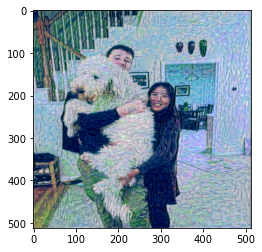

850
tensor(3592676., grad_fn=<AddBackward0>)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


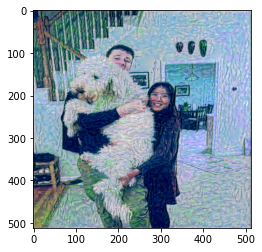

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


900
tensor(2645051., grad_fn=<AddBackward0>)


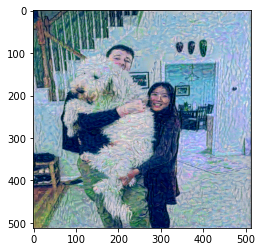

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


950
tensor(2525065.5000, grad_fn=<AddBackward0>)


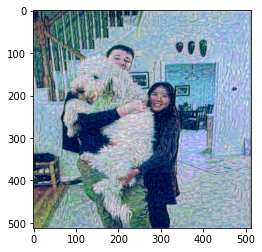

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1000
tensor(2640352., grad_fn=<AddBackward0>)


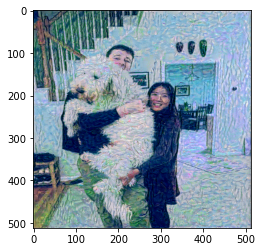

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1050
tensor(2443873.5000, grad_fn=<AddBackward0>)


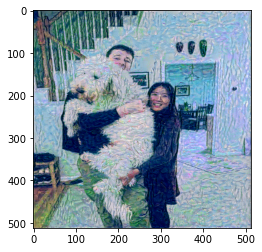

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1100
tensor(2387186.2500, grad_fn=<AddBackward0>)


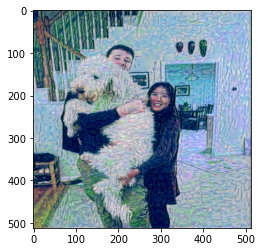

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1150
tensor(5350228.5000, grad_fn=<AddBackward0>)


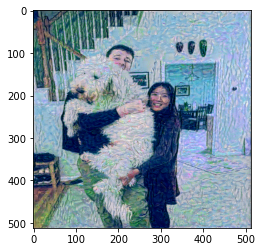

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1200
tensor(2566676.7500, grad_fn=<AddBackward0>)


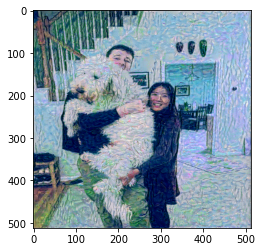

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1250
tensor(2352476.7500, grad_fn=<AddBackward0>)


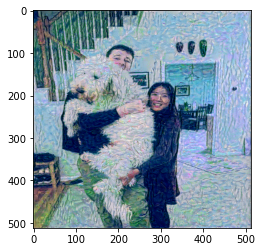

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1300
tensor(2265530.7500, grad_fn=<AddBackward0>)


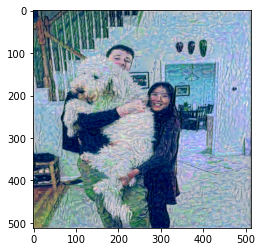

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1350
tensor(2210789.2500, grad_fn=<AddBackward0>)


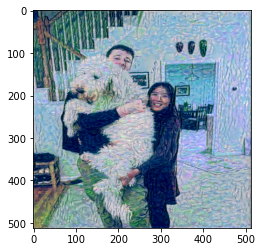

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1400
tensor(2386170.5000, grad_fn=<AddBackward0>)


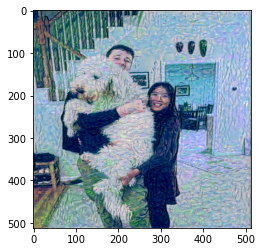

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1450
tensor(2138385.5000, grad_fn=<AddBackward0>)


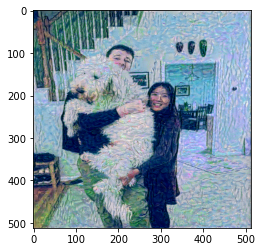

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1500
tensor(2102851.7500, grad_fn=<AddBackward0>)


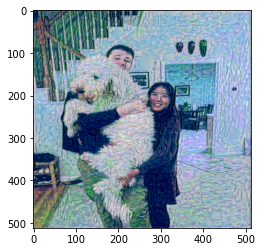

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1550
tensor(3959125.5000, grad_fn=<AddBackward0>)


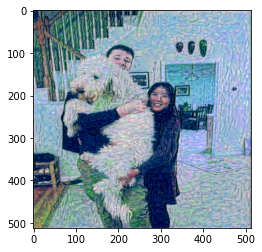

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1600
tensor(2470310.5000, grad_fn=<AddBackward0>)


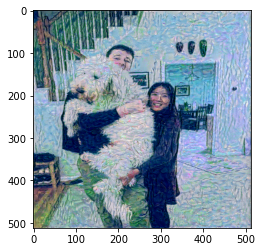

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1650
tensor(2289395., grad_fn=<AddBackward0>)


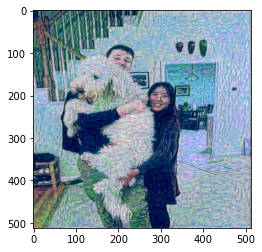

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1700
tensor(2181474.5000, grad_fn=<AddBackward0>)


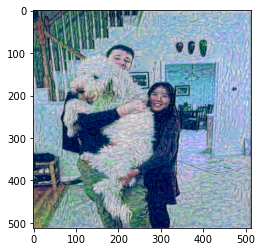

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1750
tensor(2240082., grad_fn=<AddBackward0>)


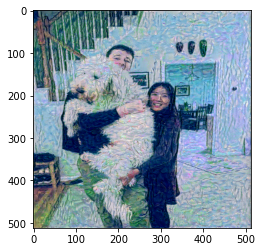

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1800
tensor(3079507.7500, grad_fn=<AddBackward0>)


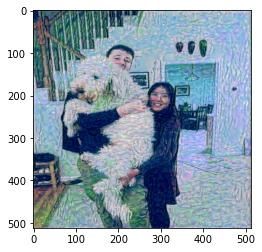

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1850
tensor(2087445.1250, grad_fn=<AddBackward0>)


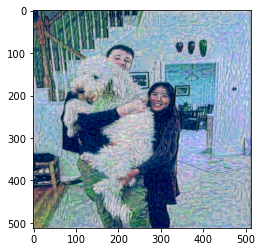

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1900
tensor(2009279.3750, grad_fn=<AddBackward0>)


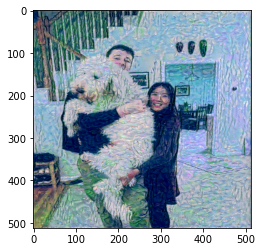

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1950
tensor(1969488.7500, grad_fn=<AddBackward0>)


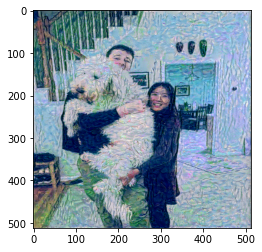

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2000
tensor(2664899.2500, grad_fn=<AddBackward0>)


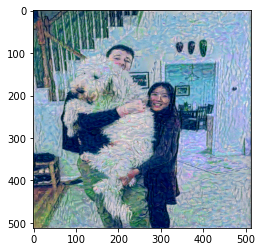

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2050
tensor(2030019.8750, grad_fn=<AddBackward0>)


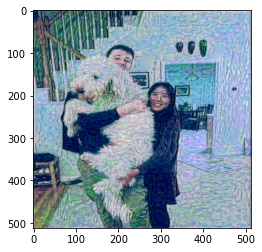

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2100
tensor(2045957.7500, grad_fn=<AddBackward0>)


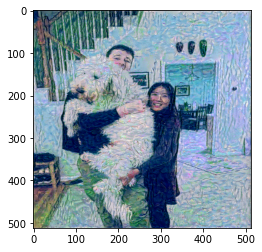

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2150
tensor(3252546.5000, grad_fn=<AddBackward0>)


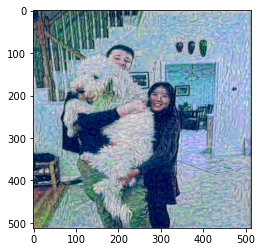

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2200
tensor(2747137.7500, grad_fn=<AddBackward0>)


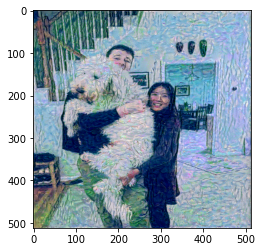

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2250
tensor(2026999.8750, grad_fn=<AddBackward0>)


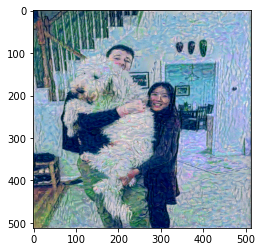

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2300
tensor(1958425.2500, grad_fn=<AddBackward0>)


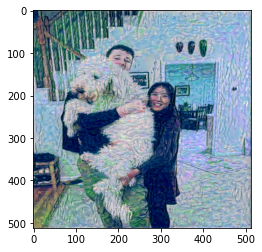

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2350
tensor(1895867.8750, grad_fn=<AddBackward0>)


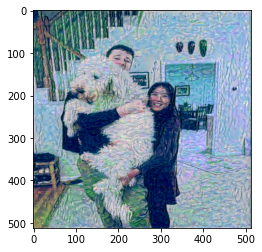

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2400
tensor(1869380.5000, grad_fn=<AddBackward0>)


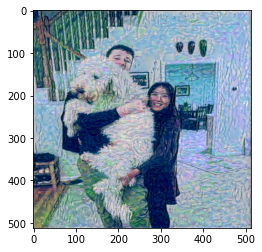

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2450
tensor(1999018.7500, grad_fn=<AddBackward0>)


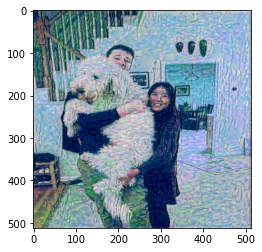

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2500
tensor(2273029.7500, grad_fn=<AddBackward0>)


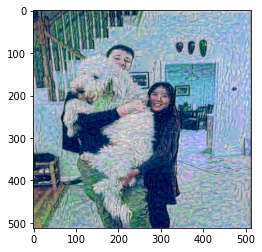

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2550
tensor(1795593.3750, grad_fn=<AddBackward0>)


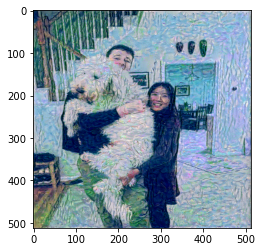

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2600
tensor(1965775.3750, grad_fn=<AddBackward0>)


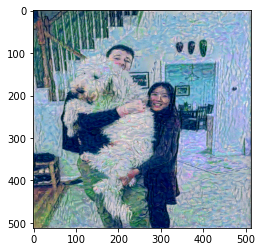

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2650
tensor(1904372.8750, grad_fn=<AddBackward0>)


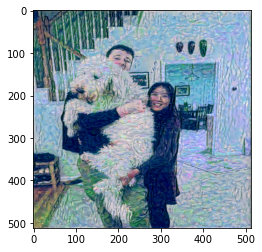

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2700
tensor(2032711.6250, grad_fn=<AddBackward0>)


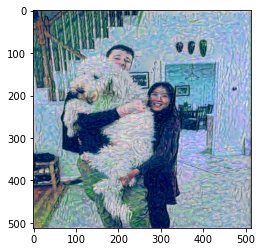

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2750
tensor(1769681., grad_fn=<AddBackward0>)


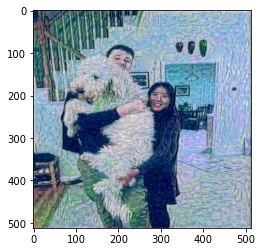

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2800
tensor(1719653.6250, grad_fn=<AddBackward0>)


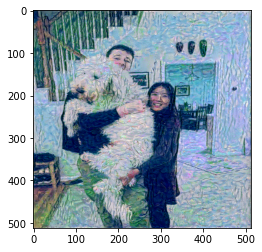

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2850
tensor(1806176.1250, grad_fn=<AddBackward0>)


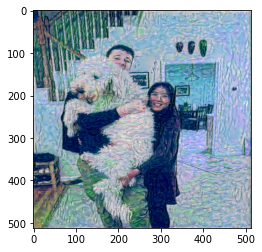

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2900
tensor(2365282., grad_fn=<AddBackward0>)


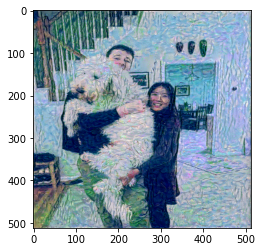

2950
tensor(1655887.6250, grad_fn=<AddBackward0>)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


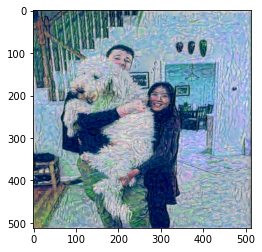

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3000
tensor(1646114.3750, grad_fn=<AddBackward0>)


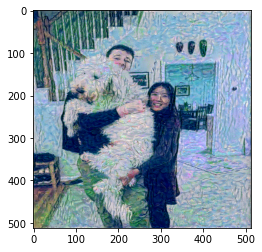

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3050
tensor(11838356., grad_fn=<AddBackward0>)


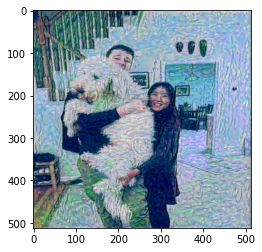

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3100
tensor(2146391.5000, grad_fn=<AddBackward0>)


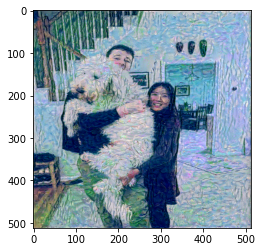

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3150
tensor(2008238.5000, grad_fn=<AddBackward0>)


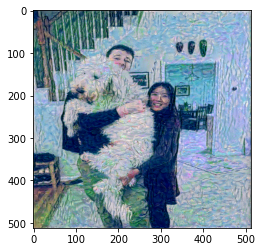

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3200
tensor(1750858.1250, grad_fn=<AddBackward0>)


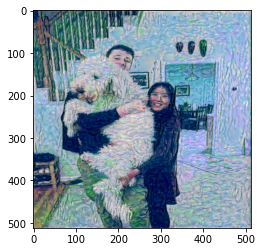

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3250
tensor(1712429., grad_fn=<AddBackward0>)


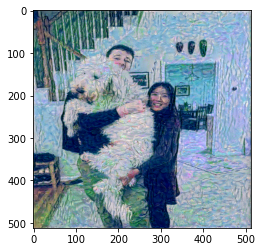

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3300
tensor(2008509.1250, grad_fn=<AddBackward0>)


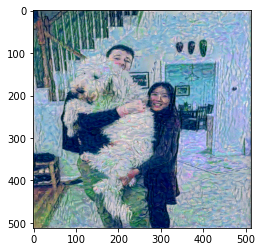

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3350
tensor(1649927.2500, grad_fn=<AddBackward0>)


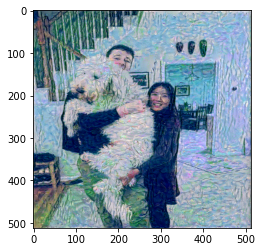

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3400
tensor(1741097.3750, grad_fn=<AddBackward0>)


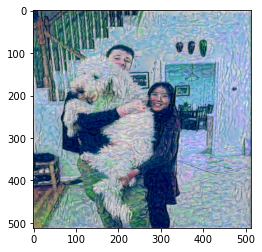

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3450
tensor(1624381.5000, grad_fn=<AddBackward0>)


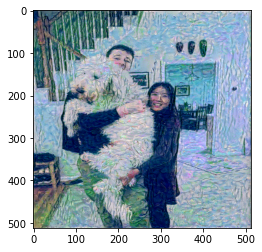

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3500
tensor(1588661.2500, grad_fn=<AddBackward0>)


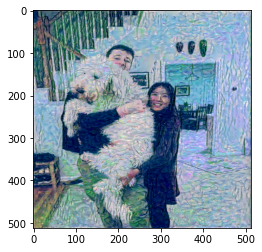

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3550
tensor(1815375.8750, grad_fn=<AddBackward0>)


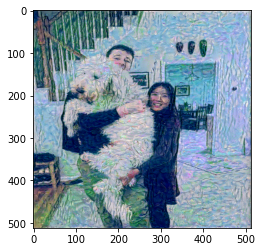

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3600
tensor(1590819.3750, grad_fn=<AddBackward0>)


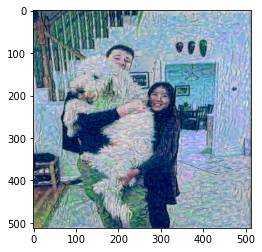

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3650
tensor(1570298.2500, grad_fn=<AddBackward0>)


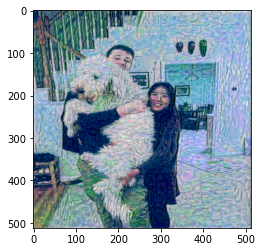

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3700
tensor(1812436.5000, grad_fn=<AddBackward0>)


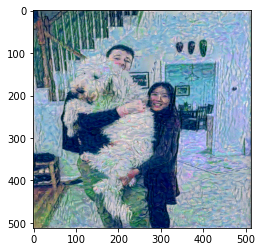

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3750
tensor(1534700.1250, grad_fn=<AddBackward0>)


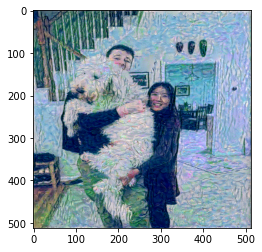

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3800
tensor(1742843.7500, grad_fn=<AddBackward0>)


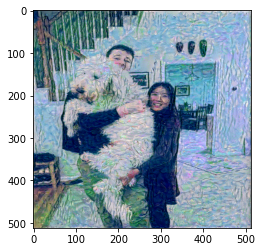

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3850
tensor(1711966.3750, grad_fn=<AddBackward0>)


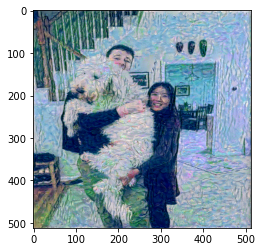

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3900
tensor(1791227., grad_fn=<AddBackward0>)


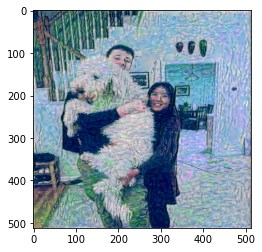

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3950
tensor(6144294.5000, grad_fn=<AddBackward0>)


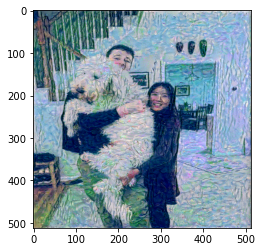

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4000
tensor(1863353.6250, grad_fn=<AddBackward0>)


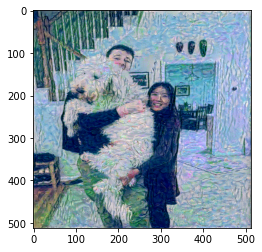

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4050
tensor(1686473.3750, grad_fn=<AddBackward0>)


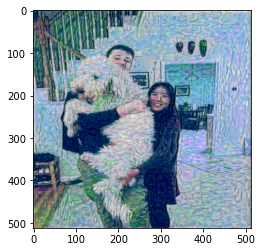

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4100
tensor(1634288.8750, grad_fn=<AddBackward0>)


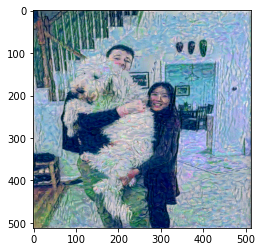

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4150
tensor(1551875., grad_fn=<AddBackward0>)


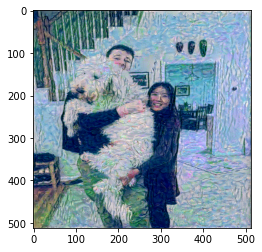

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4200
tensor(2015360.1250, grad_fn=<AddBackward0>)


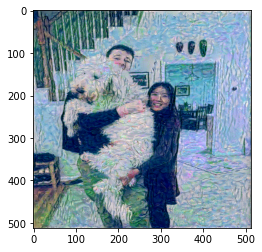

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4250
tensor(1503728.8750, grad_fn=<AddBackward0>)


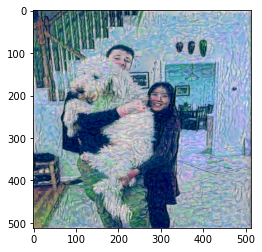

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4300
tensor(1514437.7500, grad_fn=<AddBackward0>)


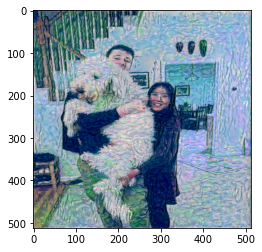

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4350
tensor(1547222.2500, grad_fn=<AddBackward0>)


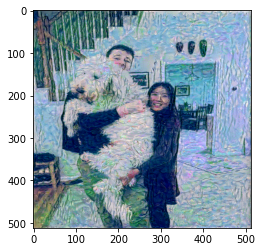

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4400
tensor(1645734.5000, grad_fn=<AddBackward0>)


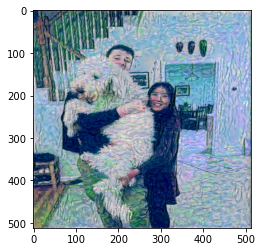

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4450
tensor(1610702.3750, grad_fn=<AddBackward0>)


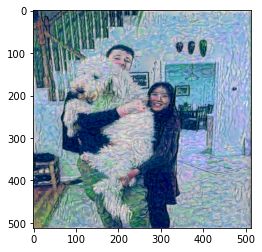

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4500
tensor(1461283.6250, grad_fn=<AddBackward0>)


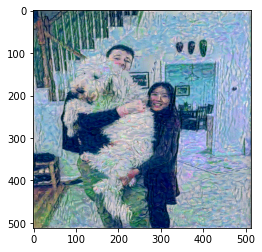

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4550
tensor(1494758.5000, grad_fn=<AddBackward0>)


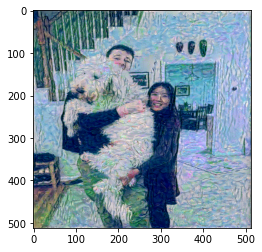

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4600
tensor(2079962.7500, grad_fn=<AddBackward0>)


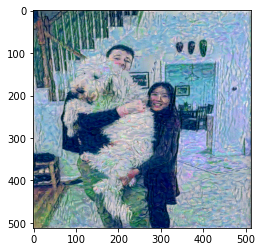

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4650
tensor(1450195.2500, grad_fn=<AddBackward0>)


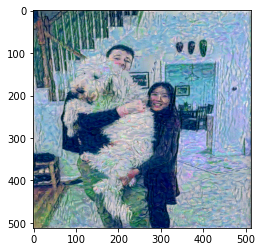

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4700
tensor(1430573.3750, grad_fn=<AddBackward0>)


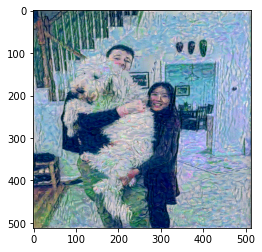

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4750
tensor(2762043.7500, grad_fn=<AddBackward0>)


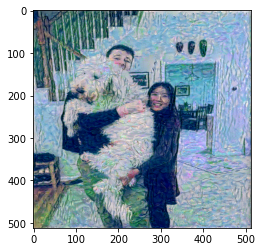

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4800
tensor(1427676.8750, grad_fn=<AddBackward0>)


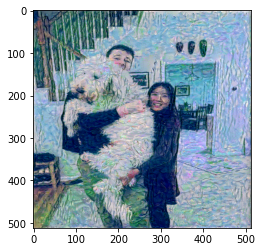

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4850
tensor(1452833.6250, grad_fn=<AddBackward0>)


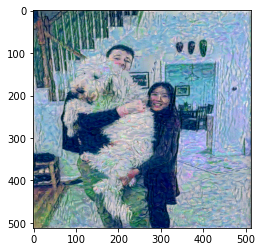

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4900
tensor(6317899., grad_fn=<AddBackward0>)


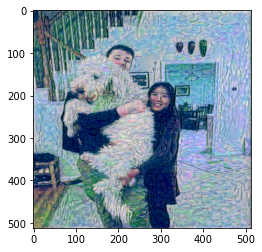

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4950
tensor(1808209., grad_fn=<AddBackward0>)


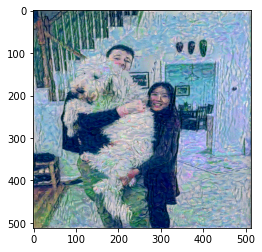

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5000
tensor(1566441.6250, grad_fn=<AddBackward0>)


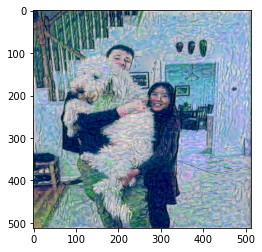

5050
tensor(1498273.5000, grad_fn=<AddBackward0>)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


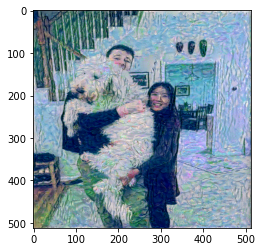

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5100
tensor(1511200.7500, grad_fn=<AddBackward0>)


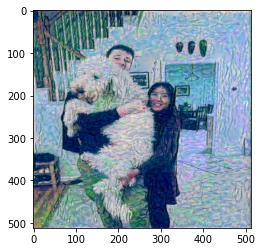

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5150
tensor(4085312.2500, grad_fn=<AddBackward0>)


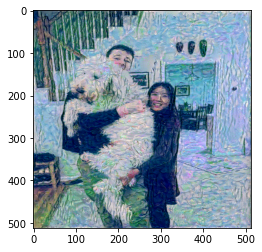

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5200
tensor(1491595.2500, grad_fn=<AddBackward0>)


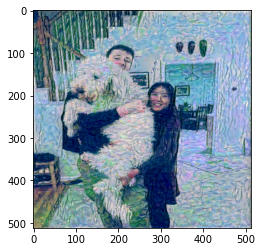

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5250
tensor(1422668.2500, grad_fn=<AddBackward0>)


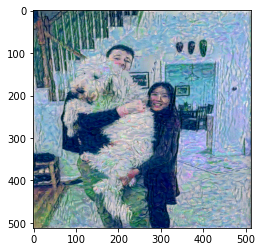

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5300
tensor(1425029.6250, grad_fn=<AddBackward0>)


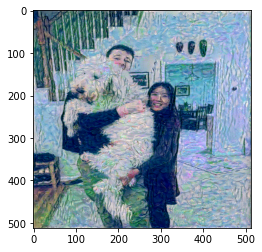

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5350
tensor(1637403.8750, grad_fn=<AddBackward0>)


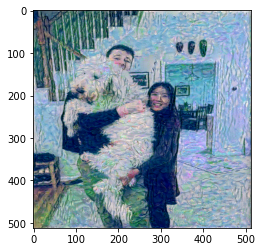

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5400
tensor(1368400.1250, grad_fn=<AddBackward0>)


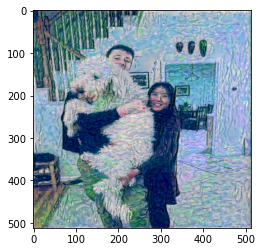

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5450
tensor(1363570.2500, grad_fn=<AddBackward0>)


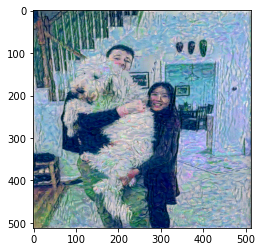

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5500
tensor(1355334.3750, grad_fn=<AddBackward0>)


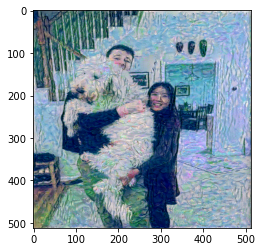

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5550
tensor(1530209.7500, grad_fn=<AddBackward0>)


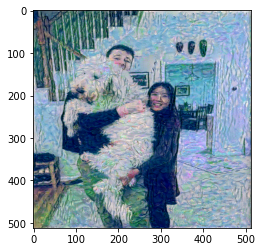

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5600
tensor(5841118., grad_fn=<AddBackward0>)


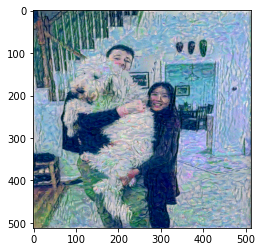

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5650
tensor(2150422.5000, grad_fn=<AddBackward0>)


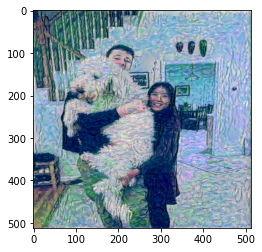

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5700
tensor(1854039.8750, grad_fn=<AddBackward0>)


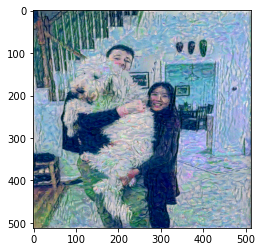

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5750
tensor(2313261.5000, grad_fn=<AddBackward0>)


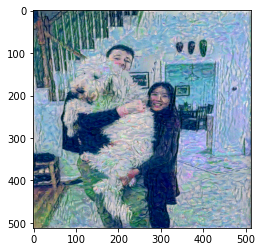

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5800
tensor(1618373.1250, grad_fn=<AddBackward0>)


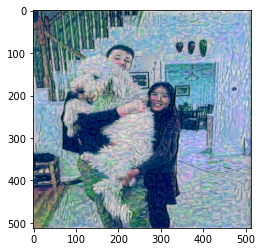

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5850
tensor(1570983.7500, grad_fn=<AddBackward0>)


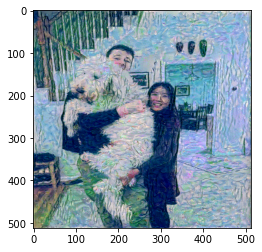

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5900
tensor(1519716.1250, grad_fn=<AddBackward0>)


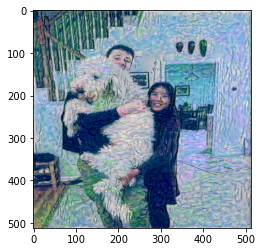

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5950
tensor(1480853.2500, grad_fn=<AddBackward0>)


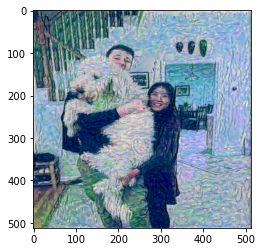

In [65]:
model = VGG().to(device).eval()
epoch = 6000
lr = 0.004
alpha = 8
beta = 70
optimizer = optim.Adam([generated_image],lr=lr)

for i in range(epoch):
    gen_features = model(generated_image)
    orig_features = model(original_image)
    style_features = model(style_image)

    total_loss = calculate_loss(gen_features,orig_features,style_features)
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()

    if(not(i%50)):
        print(i)
        print(total_loss)
        np_arr = generated_image.cpu().detach().numpy()
        np_arr2 = np.squeeze(np_arr)
        np_arr3 = np.moveaxis(np_arr2, 0,2)
        plt.imshow(np_arr3)
        plt.show()
        save_image(generated_image,'gen.png')

## Run model 

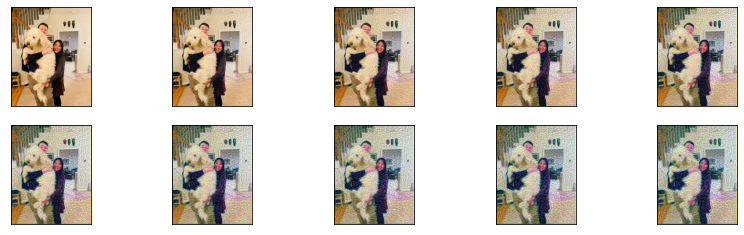

In [34]:
best, best_loss = run_style_transfer(content_path,style_path, num_iterations=100)

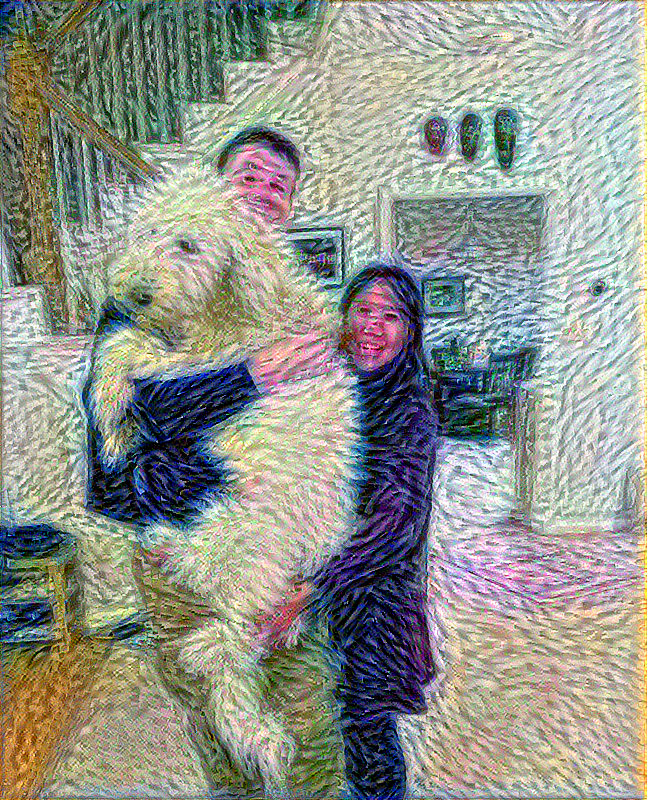

In [35]:
Image.fromarray(best)